# DATA620 - Project 2
## Team Members
* Simon Ustoyev
* Elina Azrilyan
* Jack Russo
* Anil Akyildir

## Requirements
1. Identify a large 2-node network dataset.  Your data should meet the criteria that it consists of ties between and not within two (or more) distinct groups.
2. Reduce the size of the network using a method such as the island method described in chapter 4 of social network analysis.
3. What can you infer about each of the distinct groups?

[Video Presentation](https://screencast-o-matic.com/watch/cY1veT5bDv)

## Dataset: Norwegian Interlocking Directorate (Aug-2011)
This is the interlocking directorate dataset among public companies in Norway.  The data consists of two types of nodes - companies and people (board directors of the compnanies).  More details and the source of the data can be found at http://www.boardsandgender.com/data.php

In [152]:
# Load Packages
import matplotlib.pyplot as plt
import networkx as nx
import pandas as pd
import numpy as np
from pylab import rcParams
import networkx.algorithms.bipartite as bi

In [153]:
# read Company file
dfc = pd.read_csv('http://www.boardsandgender.com/data/data_companies.txt', delim_whitespace=True, header=None,
                 names = ['id', 'org-id', 'company name', 'post code'])

# Prepend Company ID with 'C' to avoid collision with Person ID
dfc['id'] = 'C' + dfc['id'].astype(str)
dfc.head()

,id,org-id,company name,post code
0,C1,879447992,24SEVENOFFICE ASA,0667 OSLO
1,C2,990031479,A-COM NORGE ASA,0355 OSLO
2,C3,890687792,ABERDEEN EIENDOMSFOND ASIA ASA,0230 OSLO
3,C4,989761390,ABERDEEN EIENDOMSFOND NORDEN/BALTIKUM ASA,0255 OSLO
4,C5,988671258,ABERDEEN EIENDOMSFOND NORGE II ASA,0255 OSLO


In [154]:
# number of companies (boards)
print('Number of Companies: ', len(dfc))

Number of Companies:  384


In [155]:
# read People file
dfp = pd.read_csv('http://www.boardsandgender.com/data/data_people.txt',
                  delim_whitespace=True, header='infer', encoding='cp865')

# Prepend Person ID with 'P' to avoid collision with Company ID
dfp['id'] = 'P' + dfp['id'].astype(str)
dfp.head()

,id,name,gender
0,P1,Aage Jakobsen,1
1,P2,Aage Johan Rem°y,1
2,P3,Aage Rasmus Bjelland Figenschou,1
3,P4,Aagot Irene Skjeldal,2
4,P5,Aase Gundersen,2


In [156]:
# number of people
print('Number of People: ', len(dfp))

Number of People:  5767


In [157]:
# read the Affiliation file - of directors to boards (two-mode network) [as of AUG-2011]
dfcp = pd.read_csv('http://www.boardsandgender.com/data/net2m/net2m_2011-08-01.txt',
                   delim_whitespace=True, header=None, names=['target', 'source'])
dfcp['target'] = 'C' + dfcp['target'].astype(str) # Prepend Company ID with 'C'
dfcp['source'] = 'P' + dfcp['source'].astype(str) # Prepend Person ID with 'P'
dfcp.head()

,target,source
0,C1,P2149
1,C1,P2910
2,C1,P3684
3,C1,P3754
4,C2,P766


In [158]:
# number of affiliations
print('Number of Affiliations: ', len(dfcp))

Number of Affiliations:  1746


 ### Create Graph object 
 * check if it represents a (bipartite) 2-node network

In [159]:
# Creating Graph object from affiliations
B = nx.from_pandas_edgelist(dfcp)

# Check if Graph is 'bipartite'
bi.is_bipartite(B)

True

### Draw board of directors graph
* Orange hexagons represent people
* Blue nodes represent company boards

In [160]:
# Get list of "Person ID" nodes
idp = dfcp['source'].unique()

# Get list of "Company ID" nodes
idc = dfcp['target'].unique()

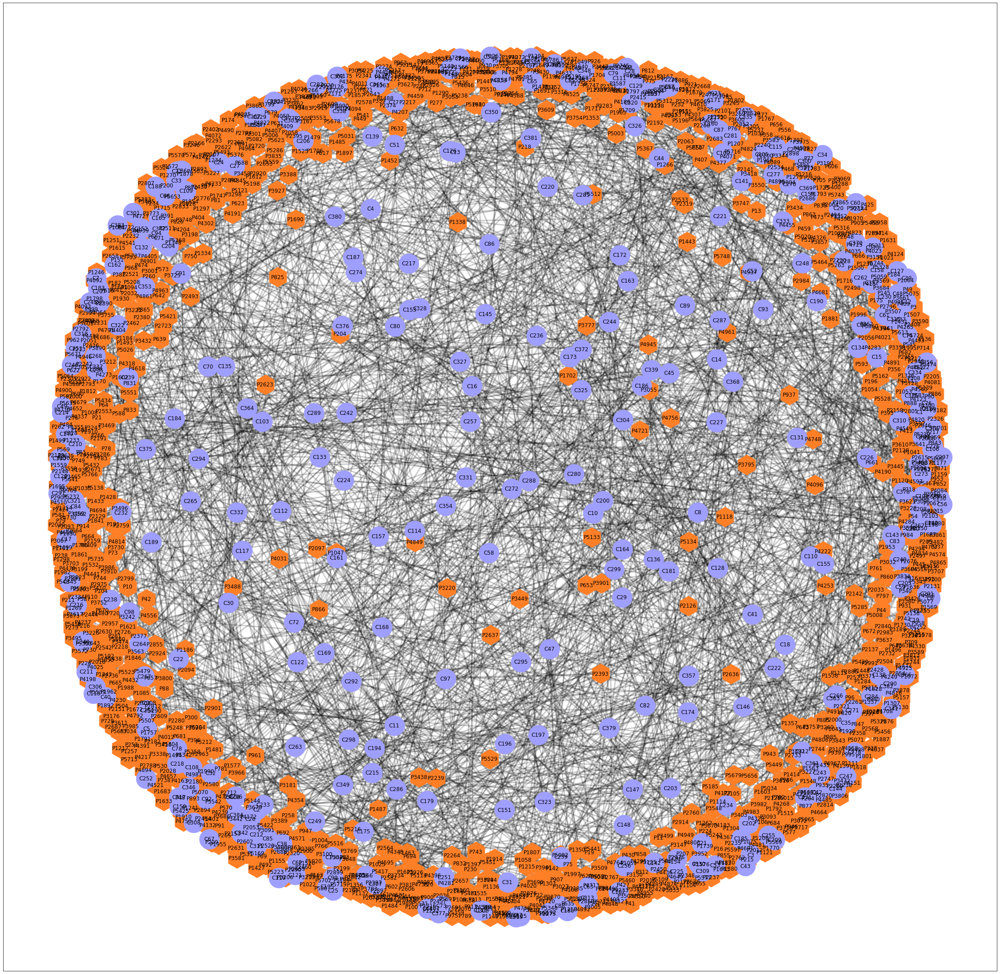

In [161]:
# Draw 2-node affiliation graph
plt.figure(figsize=(40,40))
pos = nx.spring_layout(B, k = 0.7) # Calculate layout
edg = nx.draw_networkx_edges(B, pos, width = 3, alpha = 0.2)
pnd = nx.draw_networkx_nodes(B, pos, nodelist=idp, node_color = "#ff7f27", node_shape = "h", node_size = 2000)
cnd = nx.draw_networkx_nodes(B, pos, nodelist=idc, node_color = "#9f9fff", node_size = 2000)
lbl = nx.draw_networkx_labels(B, pos)

The above affiliation graph appears to illustrate a very busy and interconnected network, which one would probably not expect considering that companies don’t usually have a lot of directors and that a person is likely to serve as a director in at most a few companies.  Below statistics give us a better glimpse into how many people serve as directors in each company as well as how many companies can a person be serving as a director.

In [162]:
# read numeric ID values from the Affiliation file
idcp = pd.read_csv('http://www.boardsandgender.com/data/net2m/net2m_2011-08-01.txt',
                   delim_whitespace=True, header=None, names=['Company', 'Person'])

In [163]:
# Order by number of People affiliations for each Company
idcp.groupby('Company').count().sort_values('Person', ascending=False)

,Person
Company,
331,12
227,11
244,10
57,10
220,10
...,...
283,3
384,3
364,2


In [165]:
print('Average number of Board Directors: ', 
      int(round(idcp.groupby('Company').count().apply(np.mean))))

Average number of Board Directors:  5


In [166]:
# Order by number of Company affiliations for each Person
idcp.groupby('Person').count().sort_values('Company', ascending=False)

,Company
Person,
3777,8
2066,7
5342,6
5134,6
1047,6
...,...
1914,1
1910,1
1900,1


In [167]:
print('Average number of Companes (that a Board Director servers on): ', 
      int(round(idcp.groupby('Person').count().apply(np.mean))))

Average number of Companes (that a Board Director servers on):  1


Despite such rather low average statistics, the below sections will illustrate how busy the co-affiliation networks can be by connecting people through affiliation in serving on the same company board and separately by connecting companies through common board directors.

### Projection Graphs

Projected graphs allow us to turn 2-node network into a single-node network.  This way we can focus our analysis on a particular type of node.  For example, we can link people together if they happened to be serving on board of directors for the same company.  Another example would be to connect one company to another and form a network of interconnected companies by defining edges to be people serving on the board of directors for more than one company.

#### Person-to-person Graph

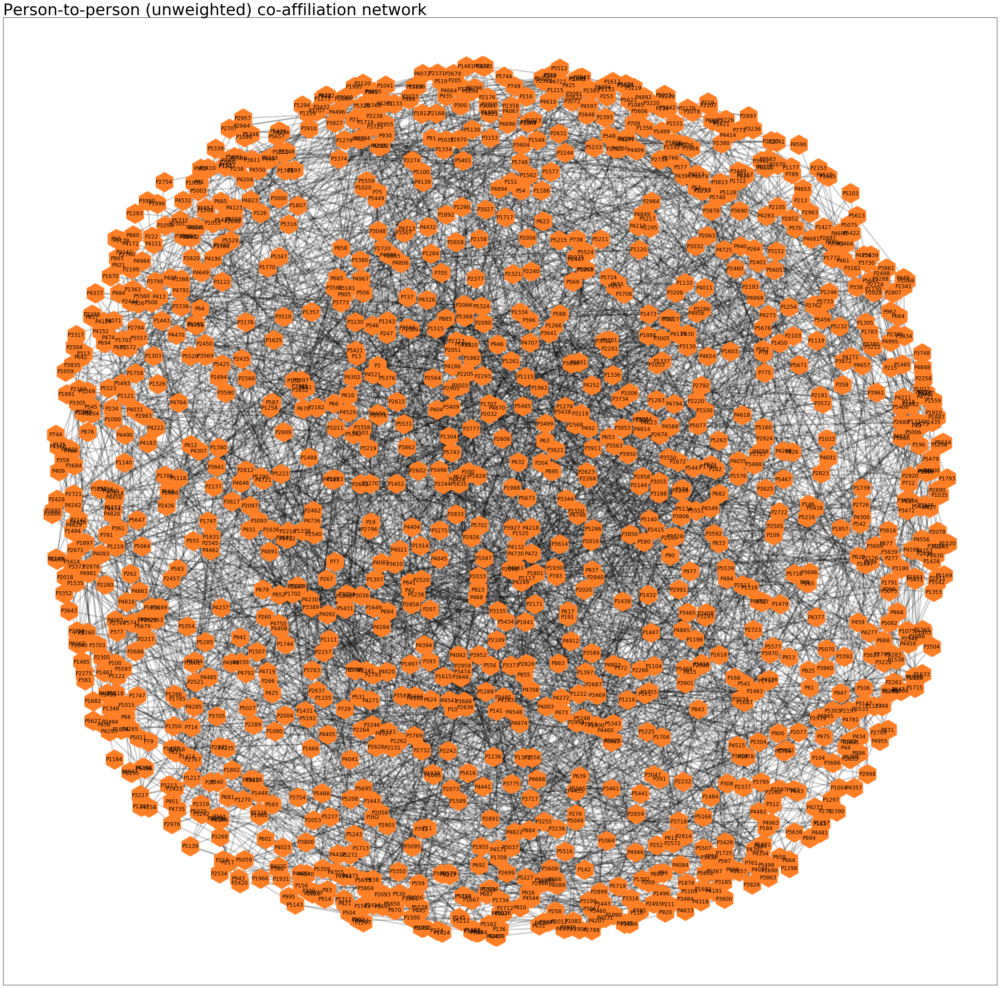

In [168]:
# Create and draw a projected graph for person-to-person network
pG = bi.projected_graph(B, idp)
plt.figure(figsize=(40, 40))
pos = nx.spring_layout(pG, k = 0.5)
edg = nx.draw_networkx_edges(pG, pos, width = 3, alpha = 0.2)
pnd = nx.draw_networkx_nodes(pG, pos,node_color = "#ff7f27", node_shape = "h", node_size = 2000)
lbl = nx.draw_networkx_labels(pG, pos, font_size = 12)
ttl = plt.title('Person-to-person (unweighted) co-affiliation network', loc = 'left', fontsize = 36)

#### Company-to-company Graph

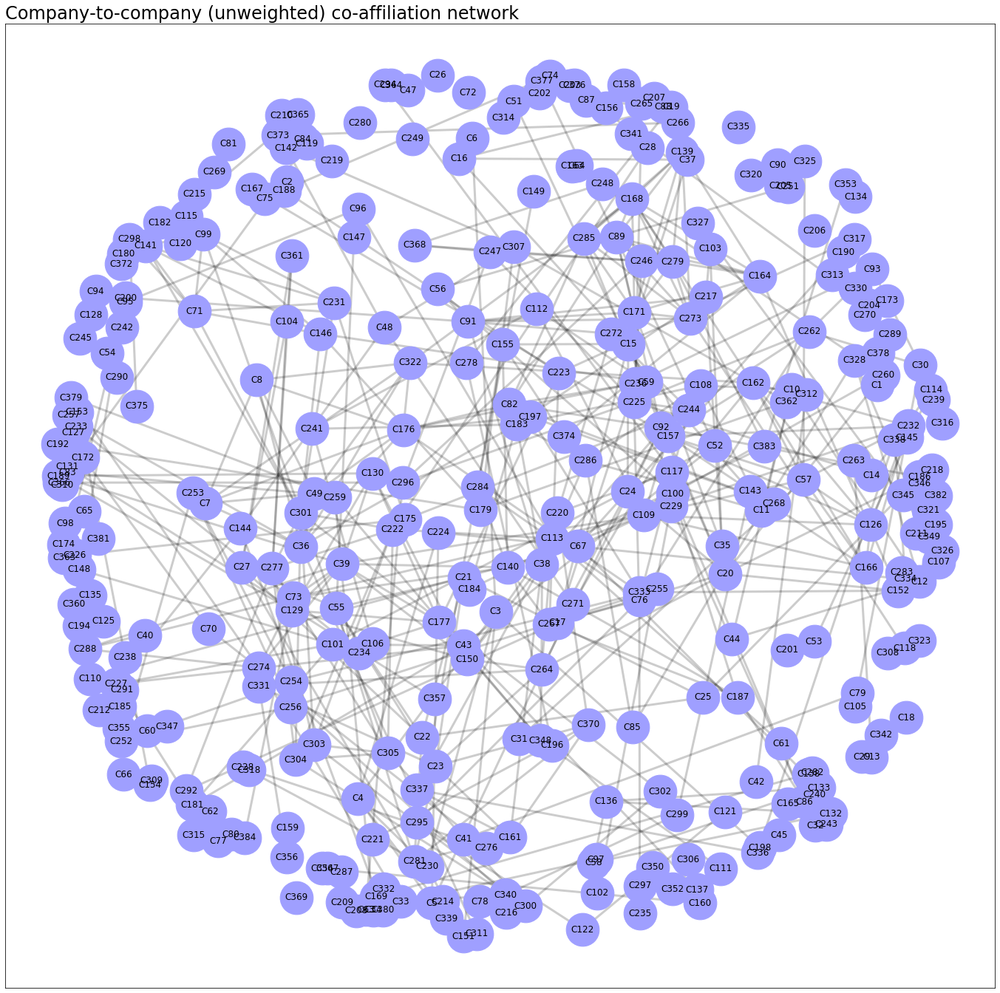

In [169]:
# Create and draw a projected graph for company-to-company network
cG = bi.projected_graph(B, idc)
plt.figure(figsize=(24, 24))
pos = nx.spring_layout(cG, k = 0.5)
edg = nx.draw_networkx_edges(cG, pos, width = 3, alpha = 0.2)
pnd = nx.draw_networkx_nodes(cG, pos,node_color = "#9f9fff", node_size = 2000)
lbl = nx.draw_networkx_labels(cG, pos, font_size = 12)
ttl = plt.title('Company-to-company (unweighted) co-affiliation network', loc = 'left', fontsize = 24)

The network graphs can be improved by showing relative strength of connections by varying the thickness and color gradient based on the weight of each connection.

#### Weighted Person-to-person Graph

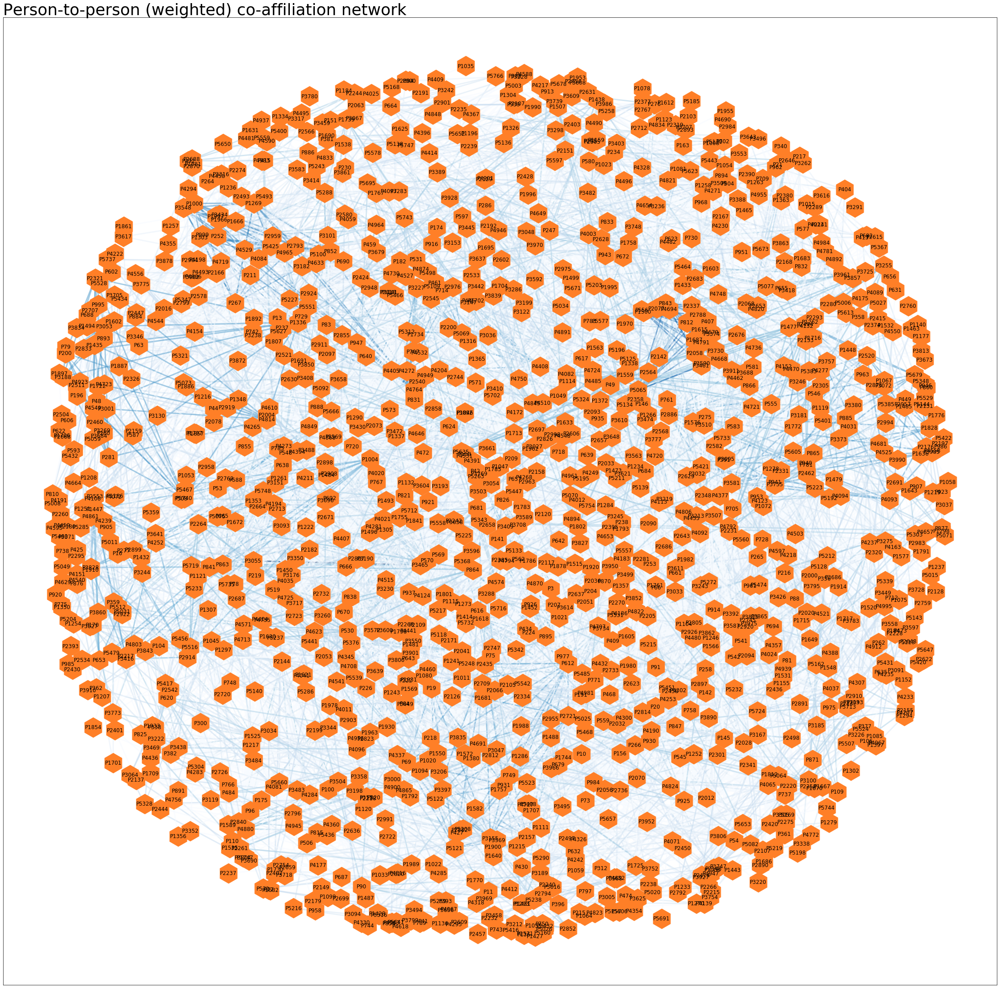

In [170]:
# Create weighted co-affiliation network
wpG = bi.weighted_projected_graph(pG, idp)

# Get weights
w = np.array([wpG.edges[e]['weight'] for e in wpG.edges])

# Create figure
plt.figure(figsize=(40,40))

# Calculate layout
pos = nx.spring_layout(wpG, k = 0.7)

# Draw edges, nodes, and labels
edg = nx.draw_networkx_edges(wpG, pos, width = 3, alpha = 0.5, edge_color = w, edge_cmap=plt.cm.Blues)
pnd = nx.draw_networkx_nodes(wpG, pos, node_color = "#ff7f27", node_shape = "h", node_size = 2000)
lbl = nx.draw_networkx_labels(wpG, pos)
ttl = plt.title('Person-to-person (weighted) co-affiliation network', loc = 'left', fontsize = 36)

#### Weighted Company-to-company Graph

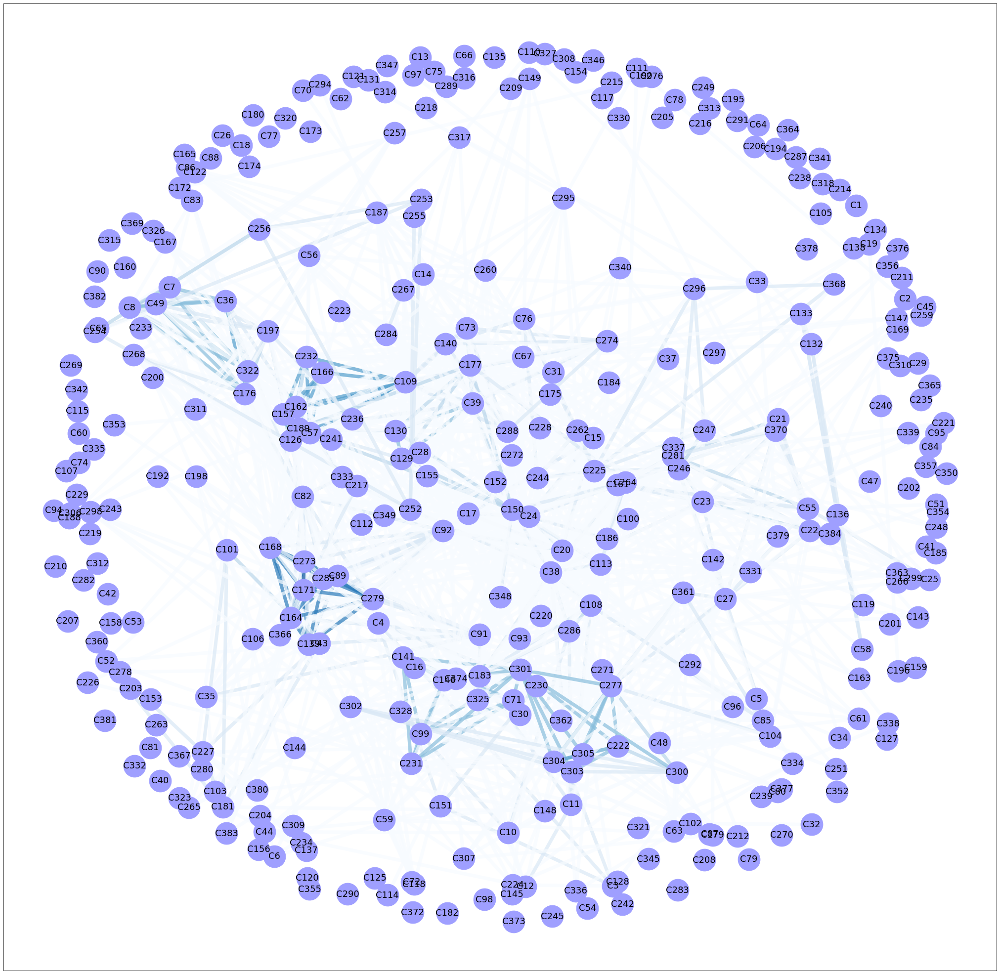

In [171]:
# Create co-affiliation network
wcG = bi.weighted_projected_graph(cG, idc)

# Get weights
w = np.array([wcG.edges[e]['weight'] for e in wcG.edges])

# Create figure
plt.figure(figsize=(36,36))

# Calculate layout
pos = nx.spring_layout(wcG, k = 0.7)

# Draw edges, nodes, and labels
edg = nx.draw_networkx_edges(wcG, pos, width = 7, alpha = 0.7, edge_color = w, edge_cmap=plt.cm.Blues)
pnd = nx.draw_networkx_nodes(wcG, pos, node_color = "#9f9fff", node_size = 2000)
lbl = nx.draw_networkx_labels(wcG, pos, font_size = 18)

Even in a weighted graph, if it is busy, it may still be difficult to see which nodes have stronger connections than others.  To help distinguish “stronger-tied” networks, we can deploy the “island method”, which will filter out connections below a certain weight threshold.

### Islands in the Network

In [172]:
'''
The ‘trim_edges’ function below takes a graph, and applies a threshold (weight), 
letting all edges above a certain value through, and removing  all others.
'''
def trim_edges(g, weight=1):
    g2 = nx.Graph()
    for f, to, edata in g.edges(data=True):
        if edata['weight'] > weight:
            g2.add_edge(f, to, weight = edata['weight'])
    return g2

'''
The ‘island_method’ function below will compute evenly spaced thresholds 
and produce a list of networks at each threshold level.
'''
def island_method(g, iterations=5):
    weights= [edata['weight'] for f,to,edata in g.edges(data=True)]
    mn=int(min(weights))
    mx=int(max(weights))
    #compute the size of the step, so we get a reasonable step in iterations
    step=int((mx-mn)/iterations)
    return [[threshold, trim_edges(g, threshold)] for threshold in range(mn,mx,step)]
    
# This function will draw "Person-Node" graph
def plot_person_node_graph(g, fig_sz=(40, 40), node_sz = 2000, spring_layout_k = 0.5):
    plt.figure(figsize=fig_sz)
    pos = nx.spring_layout(g, k = spring_layout_k)
    edg = nx.draw_networkx_edges(g, pos, width = 3, alpha = 0.2)
    pnd = nx.draw_networkx_nodes(g, pos,node_color = "#ff7f27", node_shape = "h", node_size = node_sz)
    lbl = nx.draw_networkx_labels(g, pos, font_size = 12)

# This function will draw "Company-Node" graph
def plot_company_node_graph(g, fig_sz=(24, 24), node_sz = 1000, spring_layout_k = 0.5):
    plt.figure(figsize=fig_sz)
    pos = nx.spring_layout(g, k = spring_layout_k)
    edg = nx.draw_networkx_edges(g, pos, width = 3, alpha = 0.2)
    pnd = nx.draw_networkx_nodes(g, pos, node_color = "#9f9fff", node_size = node_sz)
    lbl = nx.draw_networkx_labels(g, pos, font_size = 12)

In [173]:
islands = island_method(wpG)
for i in islands:
    # print the threshold level, size of the graph, and number of connected components
    print(i[0], len(i[1]), len(list(nx.connected_components(i[1]))))

1 1207 73
3 671 50
5 230 27
7 89 14
9 27 8
11 6 3


The numbers above can tell us, for example (on line 2), that there are 671 nodes with weight level above 3, forming 50 networks that satisfy this criterion.

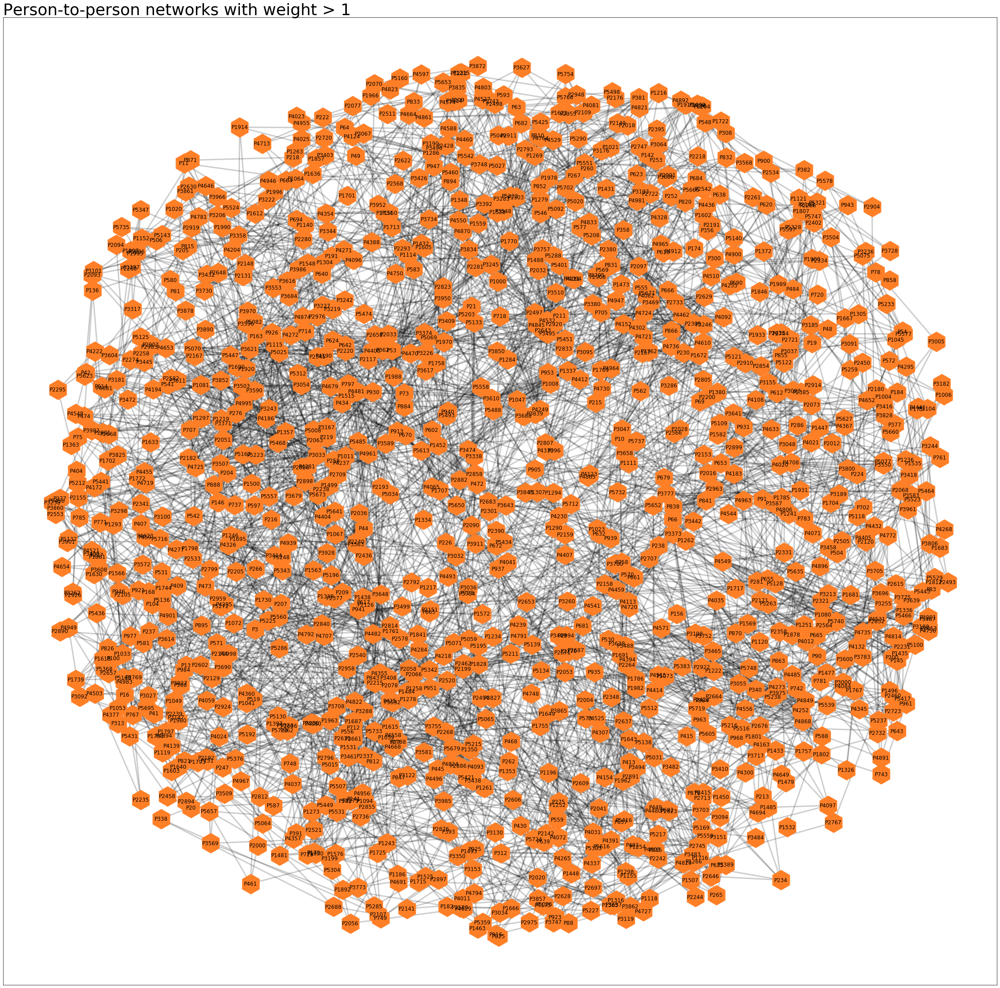

In [174]:
# Graph of islands with [1 1207 73] - line #1
ig = islands[0][1]
plot_person_node_graph(ig)
ttl = plt.title('Person-to-person networks with weight > 1', loc = 'left', fontsize = 36)

The above graph, which was reduced with weights being greater than 1, is still too busy to analyze in any meaningful way.  The next graph has been reduced more, by having weight threshold being greater than 5.  Now it became much more interesting to interpret.  We can observe clusters of connected people, which perhaps happen to serve on boards of companies that belong to the same or similar industry.  However, there are a few people (nodes) which connect and sit in between 2 or 3 different clusters.  These people can be regarded as boundary spanners (with higher level of betweenness centrality) and could perhaps be more senior people with a more versatile or broader experience.

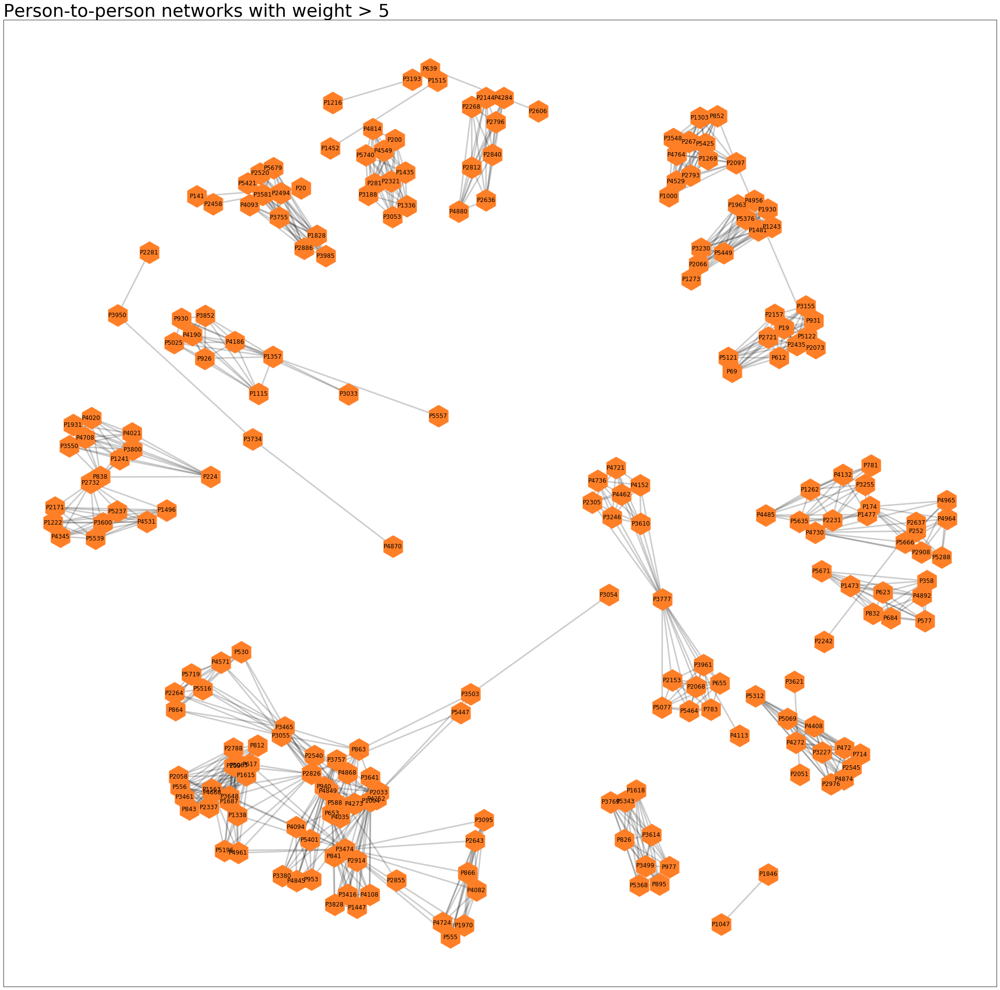

In [175]:
# Graph of islands with [5 230 27] - line #3
ig = islands[2][1]
plot_person_node_graph(ig, fig_sz=(36,36))
ttl = plt.title('Person-to-person networks with weight > 5', loc = 'left', fontsize = 36)

In the next two graphs with weights being greater than 9 or 11, there are still clusters and direct (dyad) connections, but these network components are disjoint from each other.  This is not surprising, as these components identify tightly connected group of people or individuals.

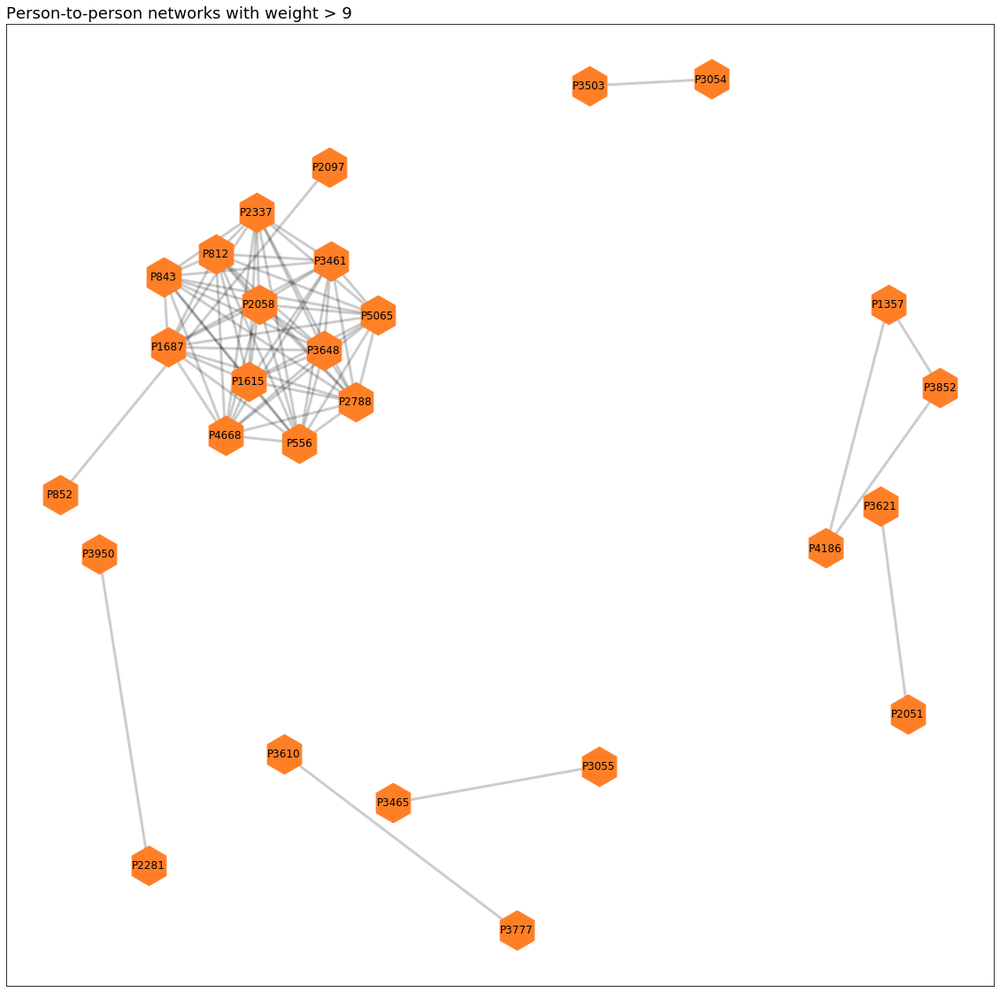

In [176]:
# Graph of islands with [9 27 8] - line #5
ig = islands[4][1]
plot_person_node_graph(ig, fig_sz=(20,20), node_sz = 2000, spring_layout_k = 2)
ttl = plt.title('Person-to-person networks with weight > 9', loc = 'left', fontsize = 18)

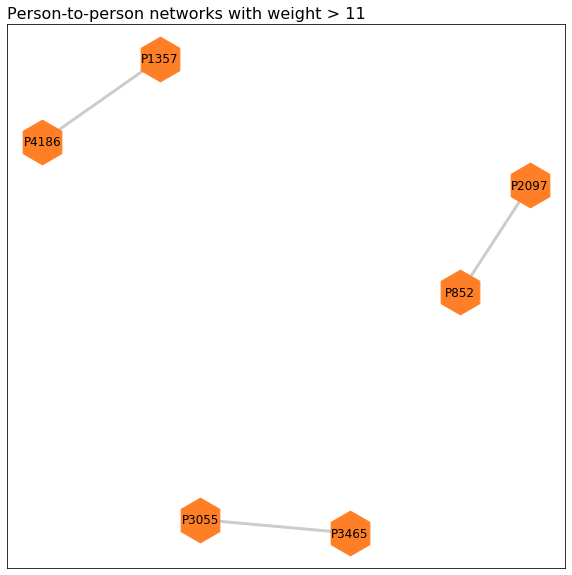

In [177]:
# Graph of islands with [11 6 3] - line #6
ig = islands[5][1]
plot_person_node_graph(ig, fig_sz=(10, 10), node_sz = 2000, spring_layout_k = 2)
ttl = plt.title('Person-to-person networks with weight > 11', loc = 'left', fontsize = 16)

Just as was done above for the person-to-person networks, we can also gradually reduce the size of company-to-company networks in order to reveal companies and cluster of companies with stronger ties, by increasing the threshold of edge weights.

In [178]:
islands = island_method(wcG)
for i in islands:
    # print the threshold level, size of the graph, and number of connected components
    print(i[0], len(i[1]), len(list(nx.connected_components(i[1]))))    

1 109 6
2 57 11
3 37 5
4 20 4
5 8 1
6 4 2
7 2 1


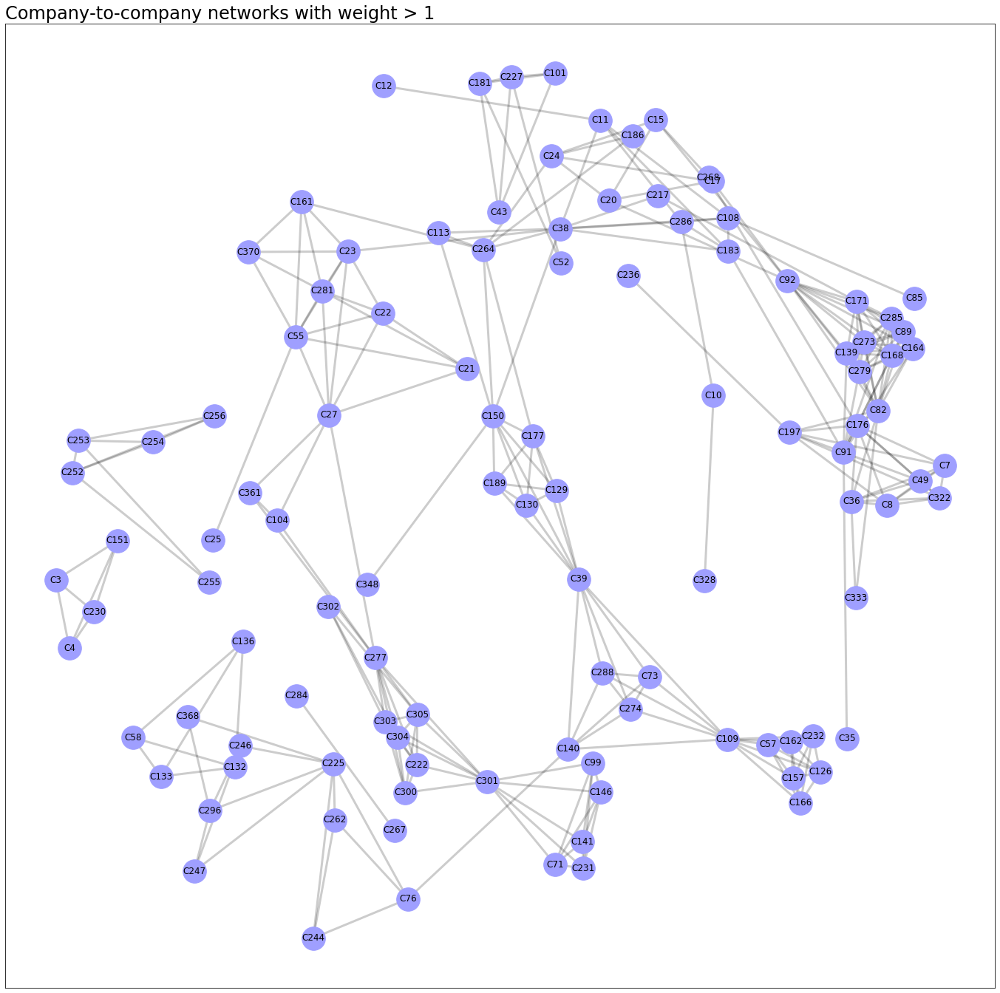

In [179]:
# Graph of islands with [1 109 6] - line #1
ig = islands[0][1]
plot_company_node_graph(ig)
ttl = plt.title('Company-to-company networks with weight > 1', loc = 'left', fontsize = 24)

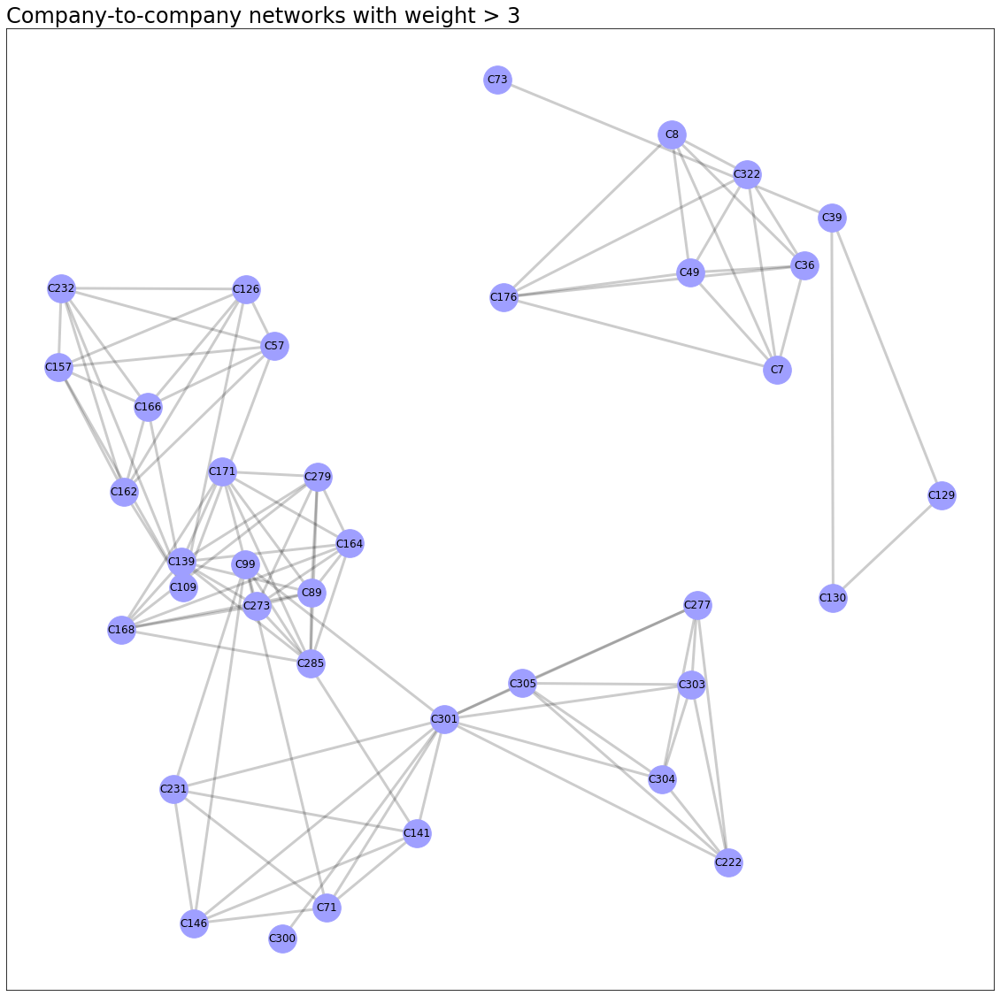

In [180]:
# Graph of islands with [3 37 5] - line #3
ig = islands[2][1]
plot_company_node_graph(ig, fig_sz=(20, 20), spring_layout_k = 1.5)
ttl = plt.title('Company-to-company networks with weight > 3', loc = 'left', fontsize = 24)

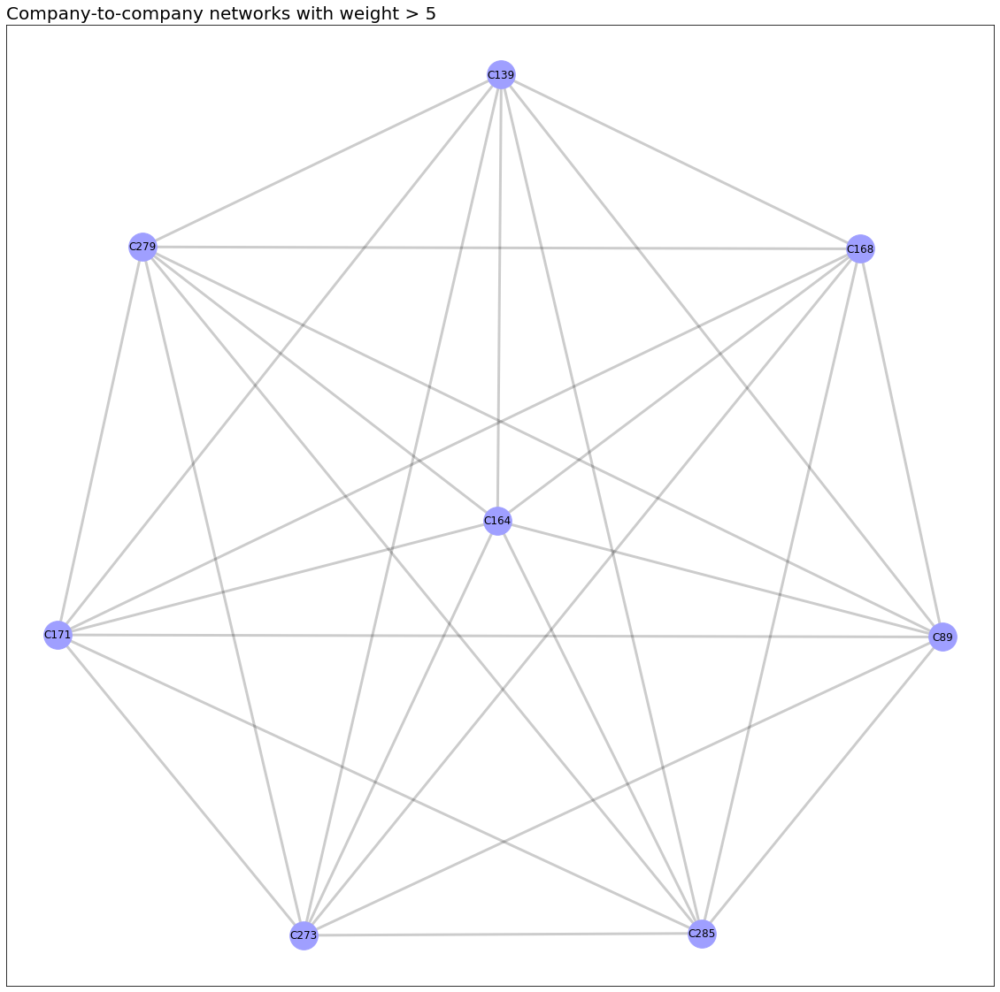

In [181]:
# Graph of islands with [5 8 1] - line #5
ig = islands[4][1]
plot_company_node_graph(ig, fig_sz=(20, 20), spring_layout_k = 1.5)
ttl = plt.title('Company-to-company networks with weight > 5', loc = 'left', fontsize = 20)

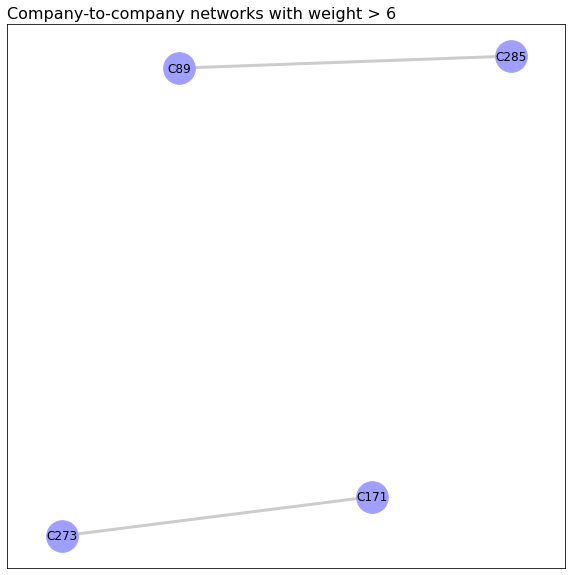

In [183]:
# Graph of islands with [6 4 2] - line #6
ig = islands[5][1]
plot_company_node_graph(ig, fig_sz=(10, 10), spring_layout_k = 1.5)
ttl = plt.title('Company-to-company networks with weight > 6', loc = 'left', fontsize = 16)

### Conclusion

Network size reduction technique, using the island-method, can be effective in identifying highly coupled group of nodes.  The reduction levels are controlled by gradually increasing the weight criterion for the edges.  In our example, such technique can help identify potential networks of people which may share a high degree of interaction by overlapping in their service as board of directors for several companies.  On the flip side, when considering networks of companies, we can identify which companies connect most to other companies by having one or more board directors in common.